# TODO

- [ ] Add a strategy based on kelly that only takes a ratio of the recommended portion 0.5 of kelly, 0.3 of kelly, etc.

In [1]:
import random
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

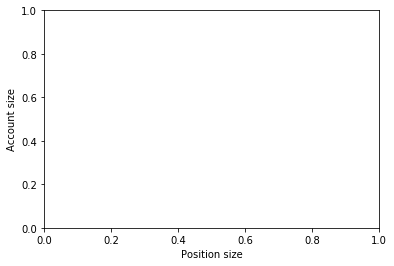

In [2]:
plt.ylabel('Account size')
plt.xlabel('Position size')
plt.rcParams['figure.figsize'] = (30, 10)

In [3]:
p_winning = 0.52

init_capital = 10000
ruin_capital = 0  # Capital that if you have it by the end, you're ruined
mdd_level = -0.30  # Desired MDD : Negative [-1, 0] : (appears as h line in CDF Maximum Drawdown)

# Control vline position on CDF graphs
percentile_avg = 0.5
percentile_below = 0.05
percentile_above = 0.95

In [4]:
def play(p=p_winning):
    roll = random.randint(1, 100)

    threshold = p * 100
    
    # User win when rolling [0, p]
    if roll <= threshold:
        return True
    
    return False

## Fixed position sizing

In this position sizing method the player always bet the same amount.

In [5]:
def fixed_bettor(funds, bet_size, plays):
    current_funds = funds
    
    bets = np.array([], dtype=int)
    funds = np.array([], dtype=int)
    drawdown = np.array([], dtype=float)
    
    for single_bet in range(plays):
        if current_funds > 0:
            if play():
                current_funds += bet_size
            else:
                current_funds -= bet_size
                
        bets = np.append(bets, single_bet)  # Add bets to samples

        # Add funds to samples
        if current_funds < 0:
            current_funds = 0
        
        funds = np.append(funds, current_funds)

        # Add drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
    
    plt.figure(0)
    plt.plot(bets, funds)
    
    plt.figure(1)
    plt.plot(bets, drawdown)
    
    return (current_funds, min(drawdown))

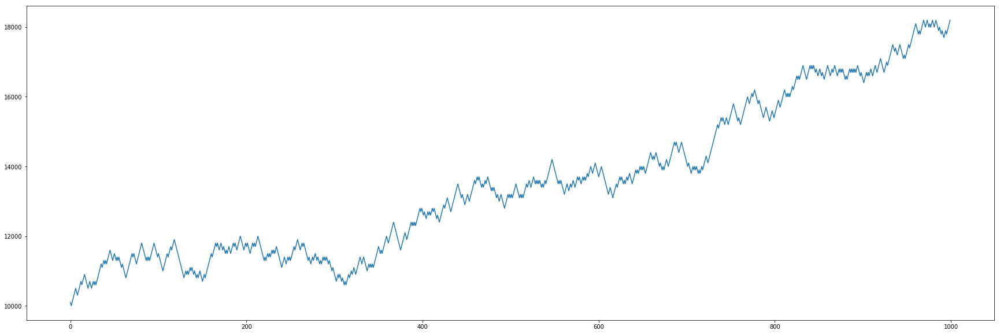

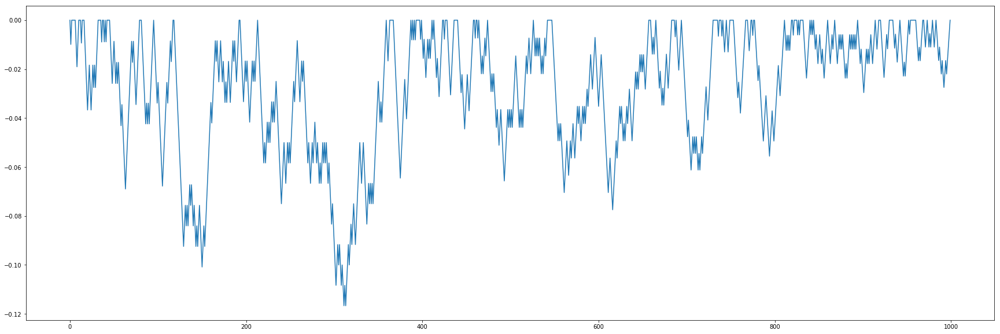

In [6]:
fixed_bettor(init_capital, 100, 1000)
plt.show()

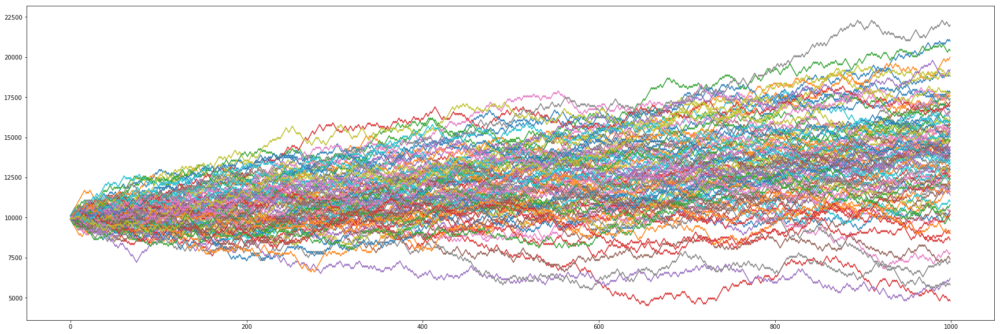

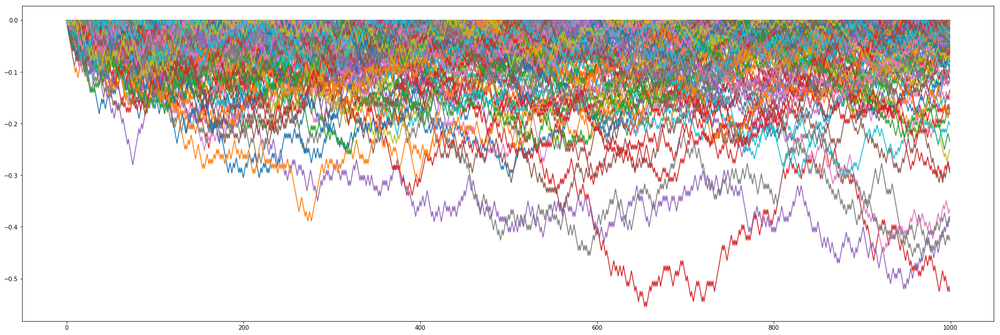

In [7]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(100):
    run_result, run_dd = fixed_bettor(init_capital, 100, 1000)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [8]:
fixed_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(fixed_results)

fixed_results['cump_balance'] = percent_unit
fixed_results['cump_dd'] = percent_unit

fixed_results['cump_balance'] = fixed_results.sort_values('balance').cump_balance.cumsum()
fixed_results['cump_dd'] = fixed_results.sort_values('drawdown').cump_dd.cumsum()

In [9]:
fixed_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,14008.000000,-0.204824,0.505000,0.505000
std,3283.373481,0.090213,0.290115,0.290115
min,4800.000000,-0.554455,0.010000,0.010000
25%,12200.000000,-0.230639,0.257500,0.257500
50%,14100.000000,-0.179286,0.505000,0.505000
75%,16000.000000,-0.150332,0.752500,0.752500
max,22000.000000,-0.076923,1.000000,1.000000


In [10]:
balance_results = fixed_results.sort_values('balance')
drawdown_results = fixed_results.sort_values('drawdown')

### CDF Ending Balance

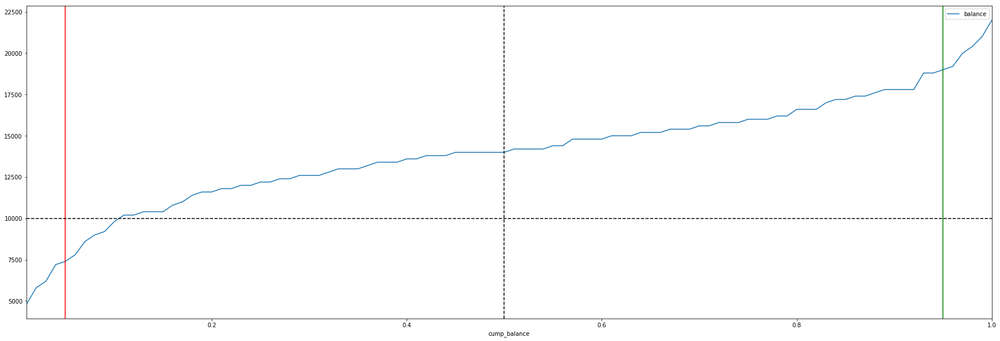

In [11]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.show()

In [12]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [13]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [14]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 42.00% or less.

There's a 5% chance that return ends at -26.00% or less.

There's a 95% chance that return ends at 90.00% or less.

11.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

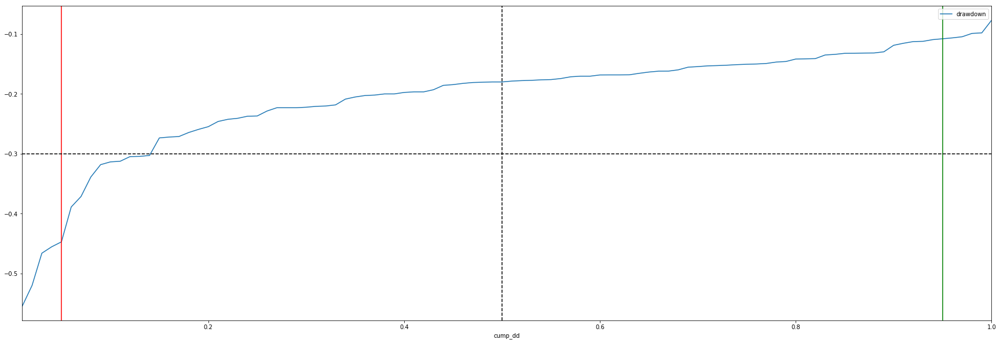

In [15]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.show()

In [16]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [17]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -17.86% or greater.

There's a 5% chance for MDD to be -44.72% or greater.

There's a 95% chance for MDD to be -10.78% or greater.

14.00% of simulations had greater MDD than -30.00%.


## Fixed percent position sizing

In each roll the player bets a fixed percentage of his current funds, in this case 2% is analyzed.

In [18]:
def percent_bettor(funds, bet_percentage, plays):
    current_funds = funds
    
    bets = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_bet in range(plays):
        if current_funds > 0:
            current_bet = current_funds * bet_percentage

            if play():
                current_funds += current_bet
            else:
                current_funds -= current_bet

        bets = np.append(bets, single_bet)
        
        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)
        
        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
            
    plt.figure(0)
    plt.plot(bets, funds)
    
    plt.figure(1)
    plt.plot(bets, drawdown)
    
    return (current_funds, min(drawdown))

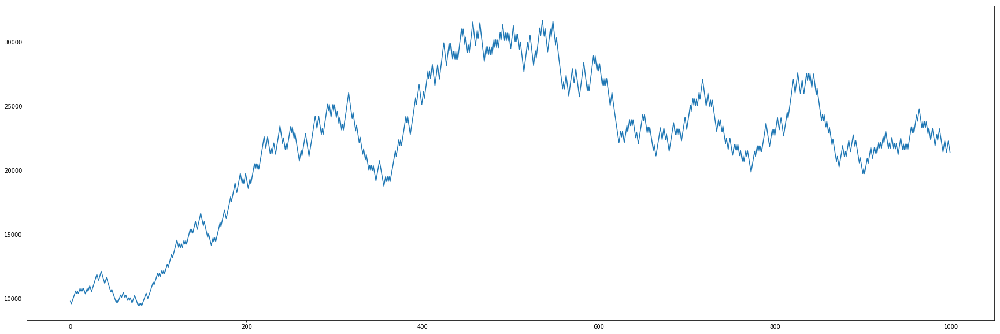

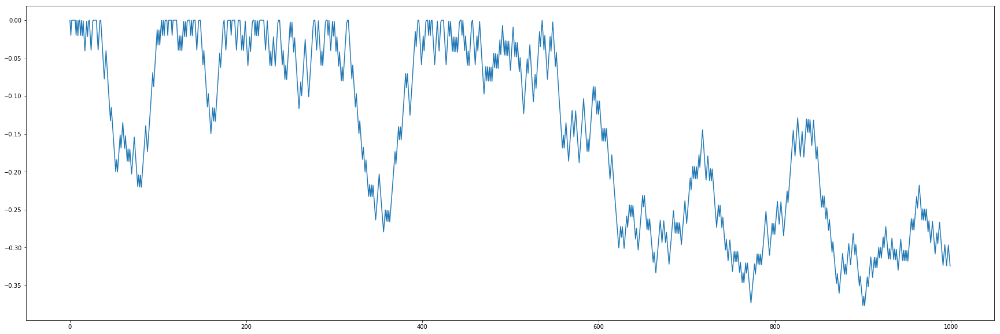

In [19]:
percent_bettor(init_capital, 0.02, 1000)
plt.show()

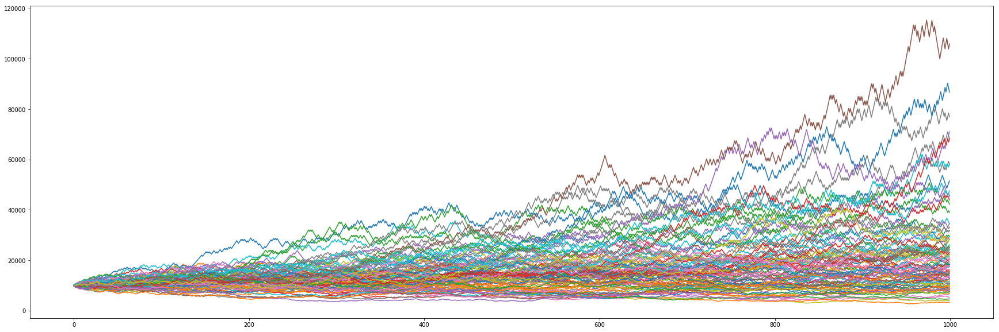

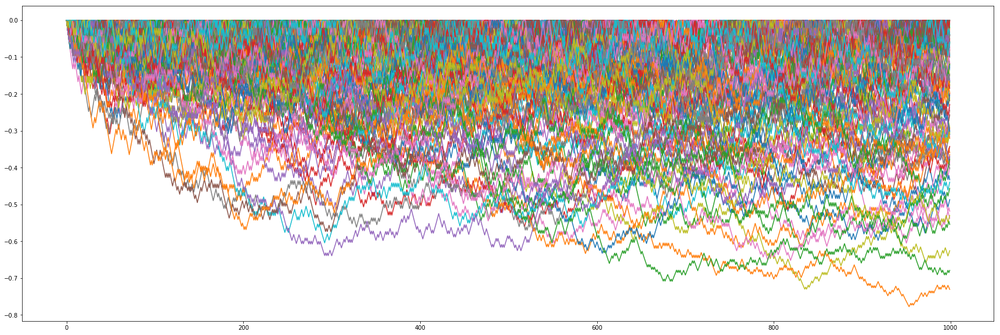

In [20]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(100):
    run_result, run_dd = percent_bettor(10000, 0.02, 1000)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)
    
plt.show()

In [21]:
percent_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(percent_results)

percent_results['cump_balance'] = percent_unit
percent_results['cump_dd'] = percent_unit

percent_results['cump_balance'] = percent_results.sort_values('balance').cump_balance.cumsum()
percent_results['cump_dd'] = percent_results.sort_values('drawdown').cump_dd.cumsum()

In [22]:
percent_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,23740.853759,-0.422452,0.505000,0.505000
std,18661.541665,0.126967,0.290115,0.290115
min,3262.267110,-0.777630,0.010000,0.010000
25%,11735.202601,-0.519773,0.257500,0.257500
50%,18222.403062,-0.405641,0.505000,0.505000
75%,28295.717139,-0.317540,0.752500,0.752500
max,105941.440951,-0.234967,1.000000,1.000000


In [23]:
balance_results = percent_results.sort_values('balance')
drawdown_results = percent_results.sort_values('drawdown')

### CDF Ending balance

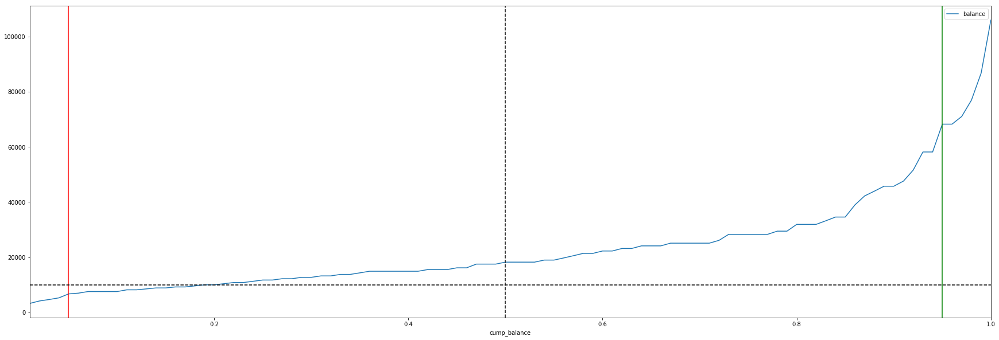

In [24]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.show()

In [25]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [26]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [27]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 82.22% or less.

There's a 5% chance that return ends at -32.97% or less.

There's a 95% chance that return ends at 582.26% or less.

21.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

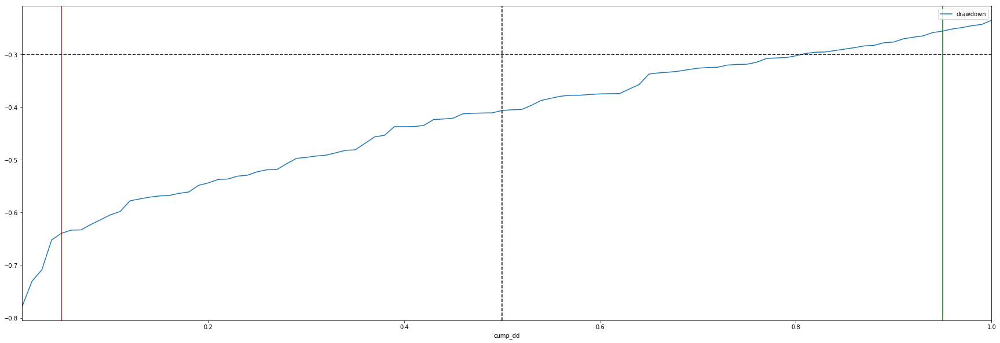

In [28]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.show()

In [29]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [30]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -40.49% or greater.

There's a 5% chance for MDD to be -63.95% or greater.

There's a 95% chance for MDD to be -25.56% or greater.

80.00% of simulations had greater MDD than -30.00%.


## Martingale position sizing

In the martingale strategy the bet size is doubled after each loss, after a win occurs the bet size returns to the initial betting size.

In [31]:
def martingale_bettor(funds, bet_size, plays):
    current_funds = funds
    current_bet = bet_size
    
    bets = np.array([], dtype=int)
    funds = np.array([], dtype=int)
    drawdown = np.array([], dtype=float)
    
    for single_bet in range(plays):
        if current_funds > 0:
            if play():
                current_funds += current_bet
                current_bet = bet_size
            else:
                current_funds -= current_bet
                current_bet *= 2
                
        bets = np.append(bets, single_bet)

        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)

        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
                
    plt.figure(0)
    plt.plot(bets, funds)
    
    plt.figure(1)
    plt.plot(bets, drawdown)
    
    return (current_funds, min(drawdown))

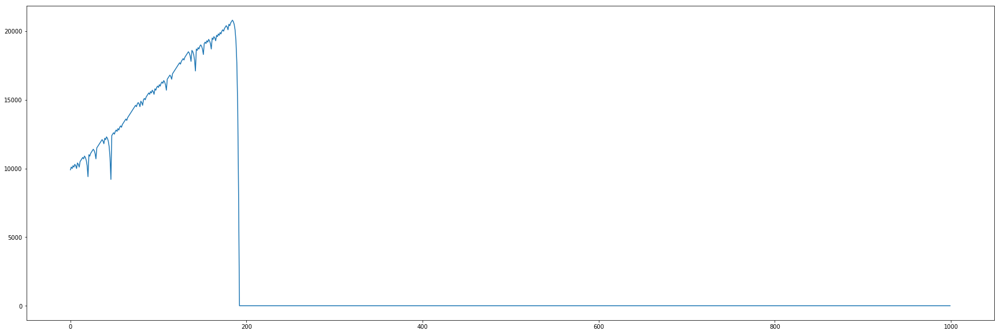

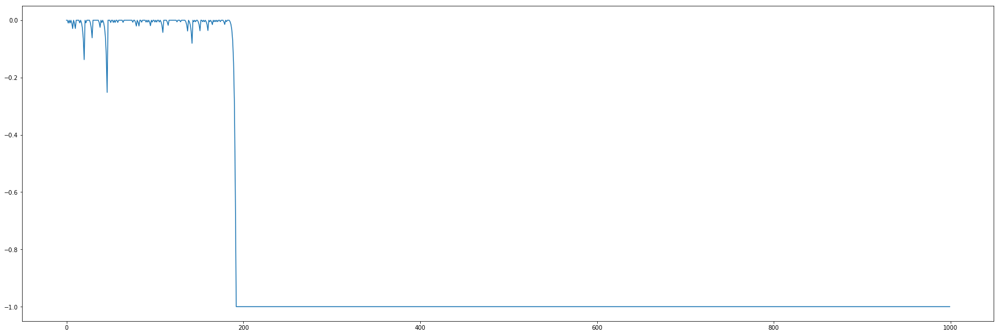

In [32]:
# Single outcome using martingale
martingale_bettor(init_capital, 100, 1000)
plt.show()

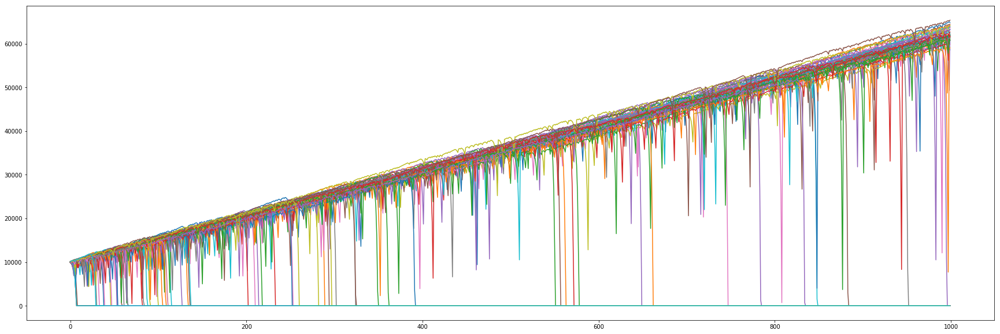

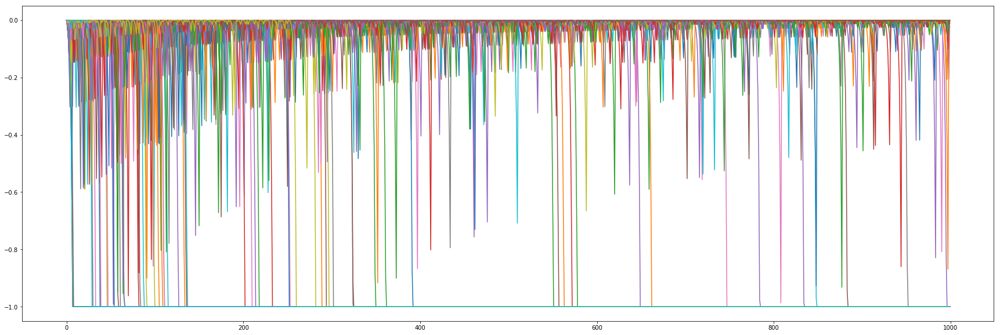

In [33]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(100):
    run_result, run_dd = martingale_bettor(init_capital, 100, 1000)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [34]:
martingale_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(martingale_results)

martingale_results['cump_balance'] = percent_unit
martingale_results['cump_dd'] = percent_unit

martingale_results['cump_balance'] = martingale_results.sort_values('balance').cump_balance.cumsum()
martingale_results['cump_dd'] = martingale_results.sort_values('drawdown').cump_dd.cumsum()

In [35]:
martingale_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,24203.000000,-0.840721,0.505000,0.505000
std,30438.294776,0.246717,0.290115,0.290115
min,0.000000,-1.000000,0.010000,0.010000
25%,0.000000,-1.000000,0.257500,0.257500
50%,0.000000,-1.000000,0.505000,0.505000
75%,61600.000000,-0.702872,0.752500,0.752500
max,65400.000000,-0.209226,1.000000,1.000000


In [36]:
balance_results = martingale_results.sort_values('balance')
drawdown_results = martingale_results.sort_values('drawdown')

### CDF Ending Balance

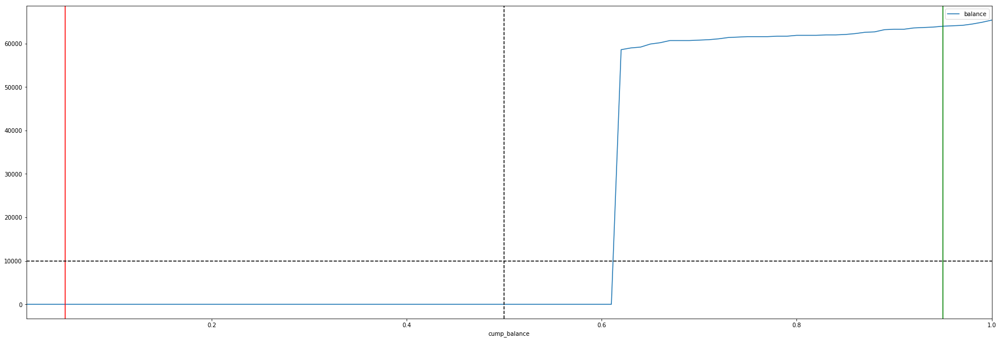

In [37]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.show()

In [38]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [39]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [40]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at -100.00% or less.

There's a 5% chance that return ends at -100.00% or less.

There's a 95% chance that return ends at 540.00% or less.

62.00% of simulations had capital lost.
61.00% of simulations lost everything.


### CDF Maximum Drawdown

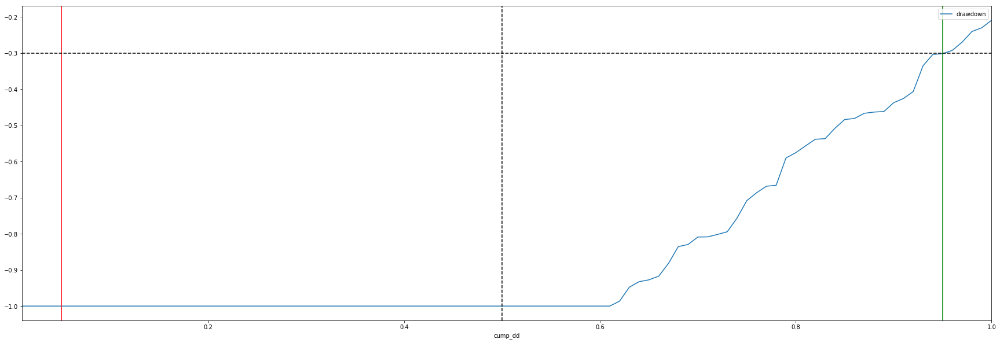

In [41]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.show()

In [42]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [43]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -100.00% or greater.

There's a 5% chance for MDD to be -100.00% or greater.

There's a 95% chance for MDD to be -30.17% or greater.

95.00% of simulations had greater MDD than -30.00%.


## Progressive position sizing

In this betting method the bet size is increased by 1/3 each time after our earnings are more than 3 times our current bet, when the player looses the bet size is set to the initial bet size.

In [44]:
def progressive_bettor(initial_funds, bet_size, plays):
    current_funds = initial_funds
    current_bet = bet_size
    
    bets = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_bet in range(plays):
        if current_funds > 0:
            if play():
                current_funds += current_bet
                earnings = initial_funds - current_funds

                if earnings > (3 * current_bet):
                    current_bet += (bet_size / 3)
                else:
                    current_bet = bet_size
            else:
                current_funds -= current_bet
                current_bet = bet_size
            
        bets = np.append(bets, single_bet)

        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)
        
        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
    
    plt.figure(0)
    plt.plot(bets, funds)
    
    plt.figure(1)
    plt.plot(bets, drawdown)
    
    return (current_funds, min(drawdown))

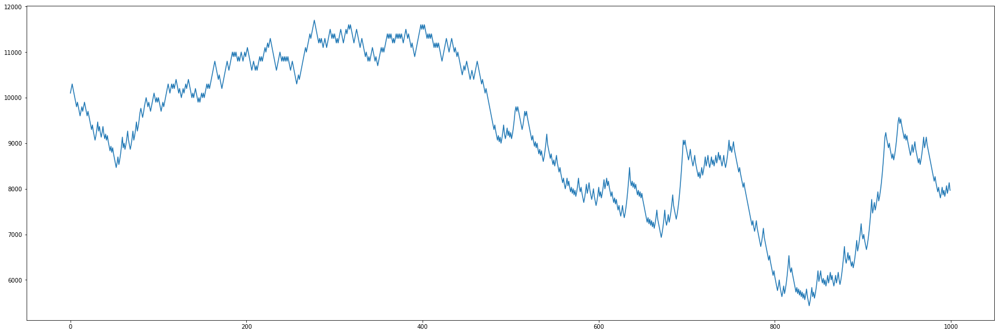

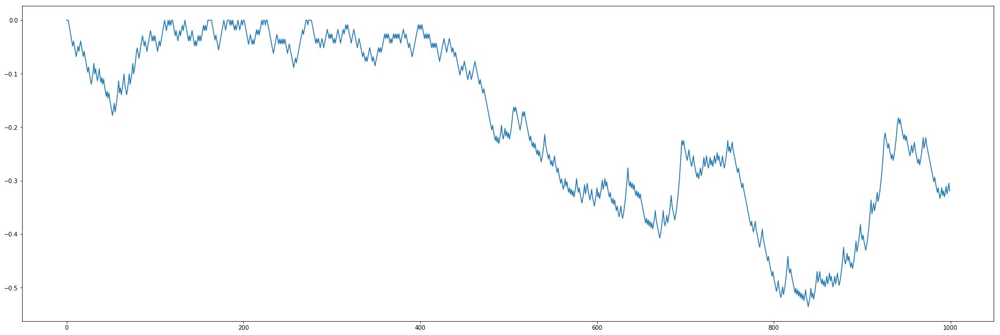

In [45]:
# Bet a 3rd of earnings on winning streaks
progressive_bettor(init_capital, 100, 1000)
plt.show()

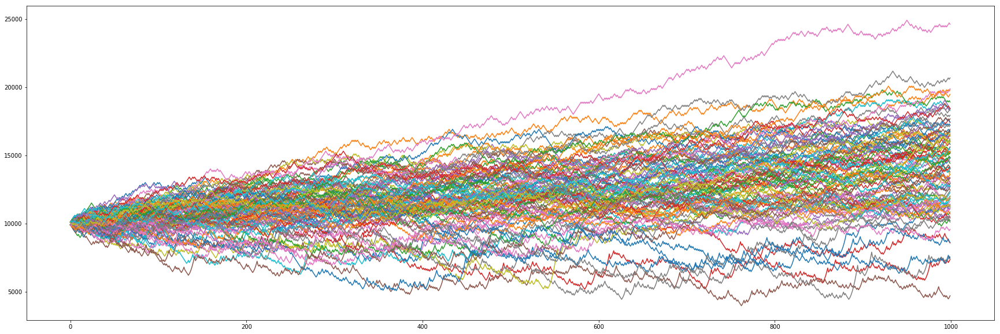

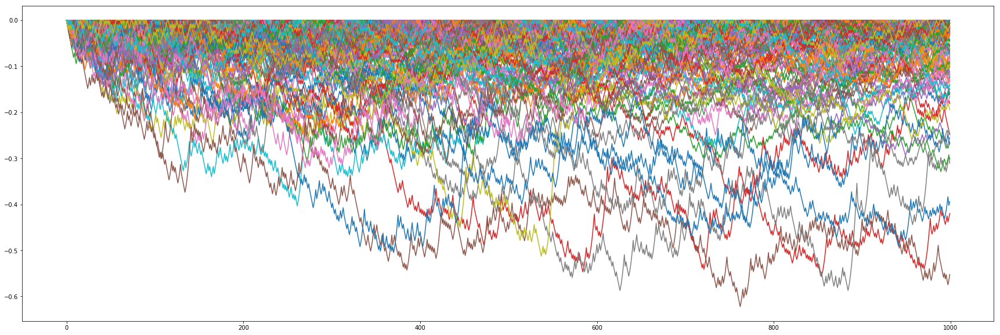

In [46]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(100):
    run_result, run_dd = progressive_bettor(init_capital, 100, 1000)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [47]:
progressive_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(progressive_results)

progressive_results['cump_balance'] = percent_unit
progressive_results['cump_dd'] = percent_unit

progressive_results['cump_balance'] = progressive_results.sort_values('balance').cump_balance.cumsum()
progressive_results['cump_dd'] = progressive_results.sort_values('drawdown').cump_dd.cumsum()

In [48]:
progressive_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,14097.333333,-0.227395,0.505000,0.505000
std,3286.412800,0.116598,0.290115,0.290115
min,4700.000000,-0.622222,0.010000,0.010000
25%,11758.333333,-0.267886,0.257500,0.257500
50%,14250.000000,-0.195071,0.505000,0.505000
75%,16250.000000,-0.148068,0.752500,0.752500
max,24600.000000,-0.066667,1.000000,1.000000


In [49]:
balance_results = progressive_results.sort_values('balance')
drawdown_results = progressive_results.sort_values('drawdown')

### CDF Ending Balance

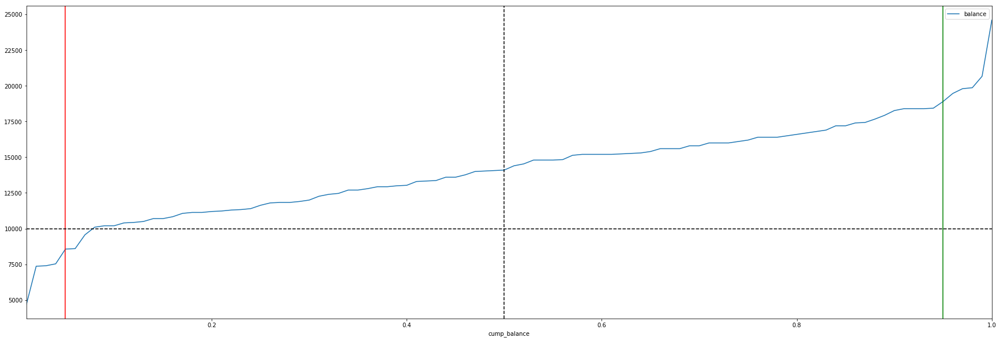

In [50]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.show()

In [51]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [52]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [53]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 44.00% or less.

There's a 5% chance that return ends at -14.33% or less.

There's a 95% chance that return ends at 89.00% or less.

8.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

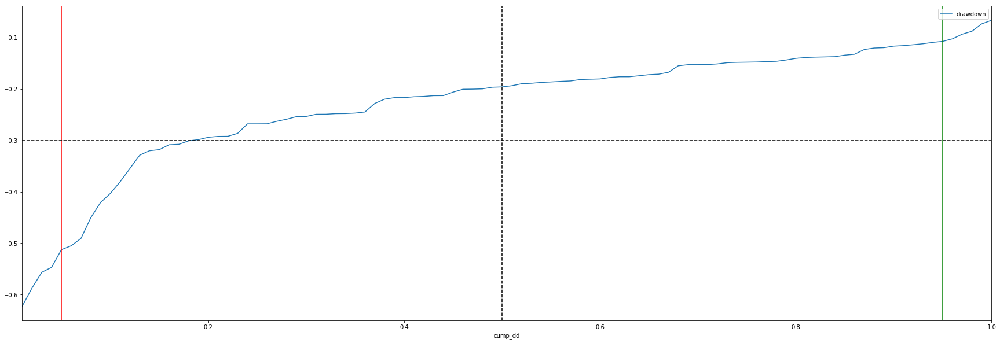

In [54]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.show()

In [55]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [56]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -19.39% or greater.

There's a 5% chance for MDD to be -51.25% or greater.

There's a 95% chance for MDD to be -10.78% or greater.

18.00% of simulations had greater MDD than -30.00%.


## Kelly Formula

Each time the player bets a percentage based in the probability of winning, is expressed as `f = p - q` where:

- `f = funds percentage to bet`
- `p = P(Wining)`
- `q = 1 - p`

### Static

The probability of winning never changes

In [57]:
def kelly_bettor(funds, plays):
    current_funds = funds
    q = 1 - p_winning
    
    bets = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_bet in range(plays):
        if current_funds > 0:
            current_bet = current_funds * (p_winning - q)

            if play():
                current_funds += current_bet
            else:
                current_funds -= current_bet

        bets = np.append(bets, single_bet)
        
        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)

        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
        
    plt.figure(0)
    plt.plot(bets, funds)
    
    plt.figure(1)
    plt.plot(bets, drawdown)
    
    return (current_funds, min(drawdown))

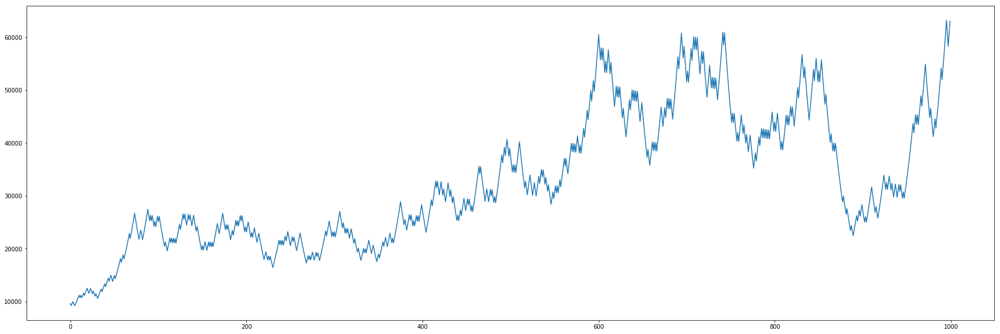

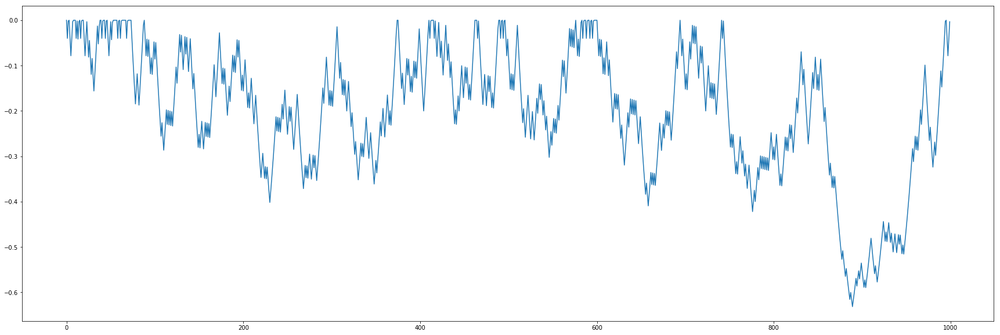

In [58]:
kelly_bettor(init_capital, 1000)
plt.show()

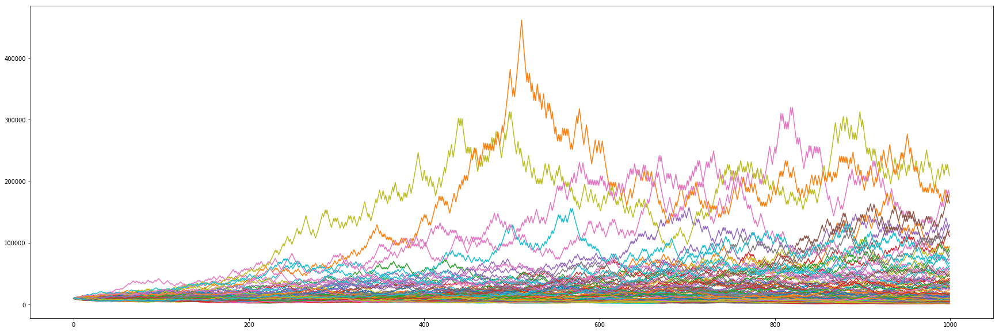

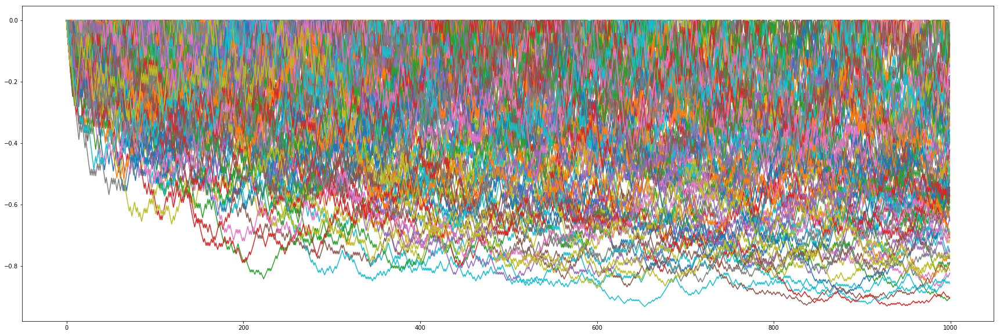

In [59]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(100):
    run_result, run_dd = kelly_bettor(init_capital, 1000)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)
    
plt.show()

In [60]:
kelly_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(kelly_results)

kelly_results['cump_balance'] = percent_unit
kelly_results['cump_dd'] = percent_unit

kelly_results['cump_balance'] = kelly_results.sort_values('balance').cump_balance.cumsum()
kelly_results['cump_dd'] = kelly_results.sort_values('drawdown').cump_dd.cumsum()

In [61]:
kelly_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,36236.159046,-0.695687,0.505000,0.505000
std,42482.983513,0.118875,0.290115,0.290115
min,1464.254885,-0.932521,0.010000,0.010000
25%,8518.890172,-0.784200,0.257500,0.257500
50%,17508.219213,-0.691523,0.505000,0.505000
75%,45749.594671,-0.611281,0.752500,0.752500
max,209347.254471,-0.437144,1.000000,1.000000


In [62]:
balance_results = kelly_results.sort_values('balance')
drawdown_results = kelly_results.sort_values('drawdown')

### CDF Ending Balance

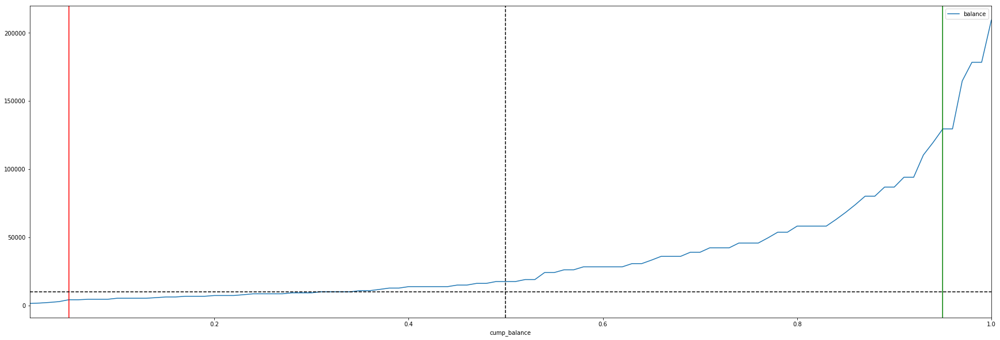

In [63]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.show()

In [64]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [65]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [66]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 75.08% or less.

There's a 5% chance that return ends at -58.55% or less.

There's a 95% chance that return ends at 1195.07% or less.

35.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

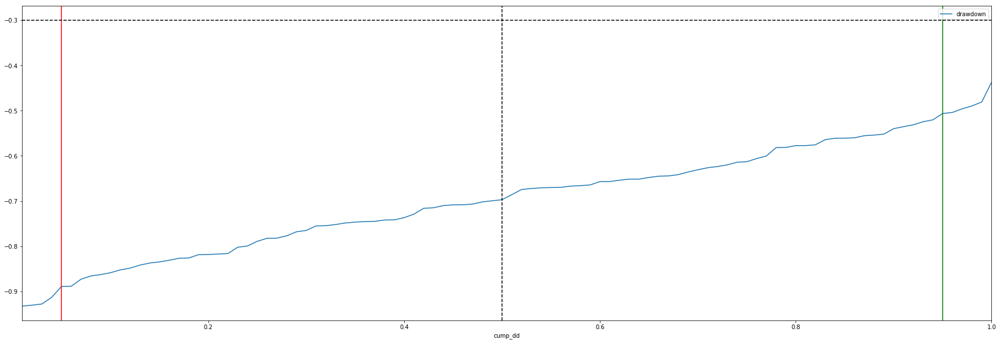

In [67]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.show()

In [68]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [69]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -68.60% or greater.

There's a 5% chance for MDD to be -88.92% or greater.

There's a 95% chance for MDD to be -50.64% or greater.

100.00% of simulations had greater MDD than -30.00%.


### Dynamic

The probability of winning varies between X and Y.

In [70]:
def kelly_bettor_dynamic(initial_funds, plays):
    current_funds = initial_funds
    
    bets = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_bet in range(plays):
        if current_funds > 0:
            chance_winning = np.random.normal(52, 4)  # With mean = 55, std = 5, 94% of the times the player wins 
            chance_loosing = 100 - chance_winning

            percent_bet = abs(chance_winning - chance_loosing) / 100
            current_bet = math.floor(current_funds * percent_bet)

            if play(p=(chance_winning / 100)):
                current_funds += current_bet
            else:
                current_funds -= current_bet

        bets = np.append(bets, single_bet)

        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)

        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
            
    plt.figure(0)
    plt.plot(bets, funds)
    
    plt.figure(1)
    plt.plot(bets, drawdown)
    
    return (current_funds, min(drawdown))

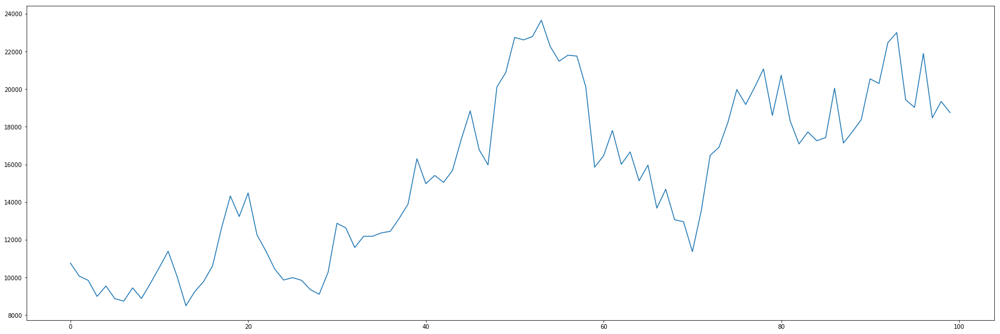

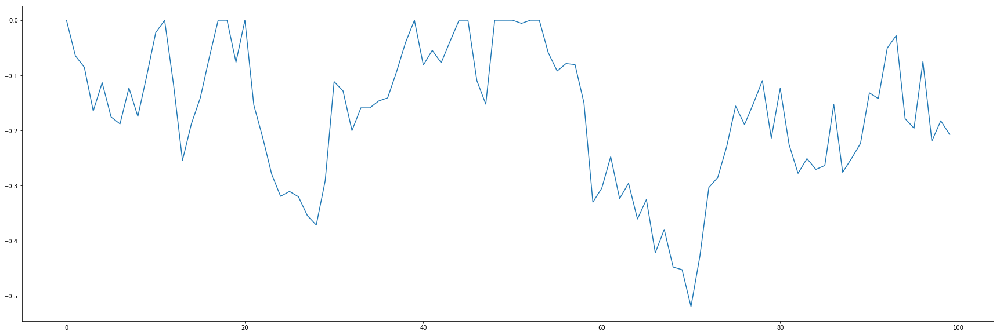

In [71]:
kelly_bettor_dynamic(init_capital, 100)
plt.show()

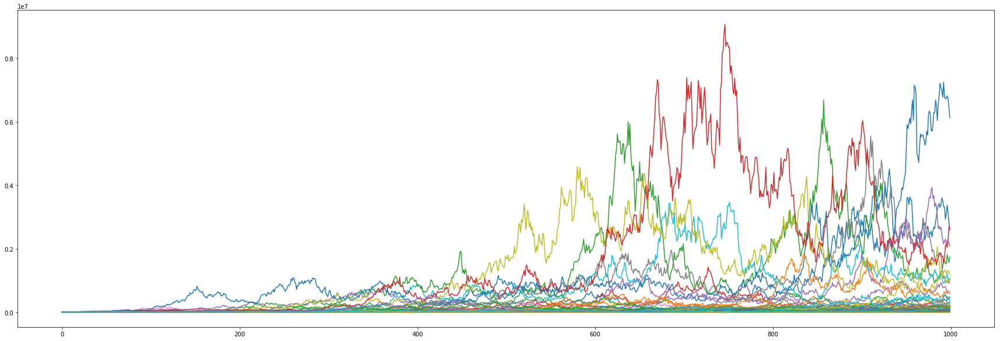

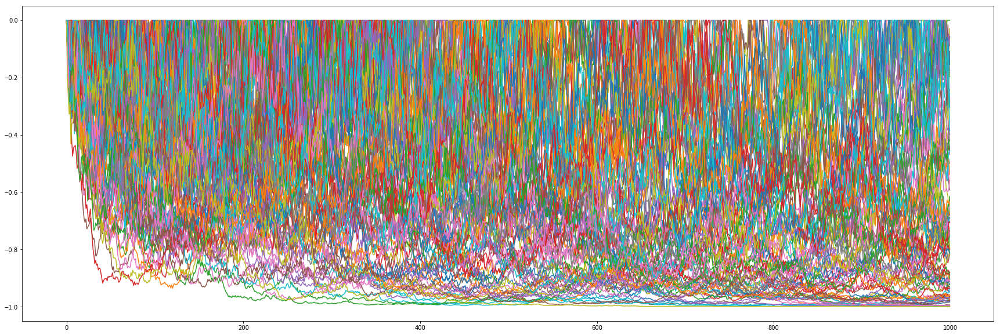

In [72]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(100):
    run_result, run_dd = kelly_bettor_dynamic(init_capital, 1000)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [73]:
kellyd_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(kellyd_results)

kellyd_results['cump_balance'] = percent_unit
kellyd_results['cump_dd'] = percent_unit

kellyd_results['cump_balance'] = kellyd_results.sort_values('balance').cump_balance.cumsum()
kellyd_results['cump_dd'] = kellyd_results.sort_values('drawdown').cump_dd.cumsum()

In [74]:
kellyd_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,1.000000e+02,100.000000,100.000000,100.000000
mean,2.639248e+05,-0.927288,0.505000,0.505000
std,7.681139e+05,0.062580,0.290115,0.290115
min,1.800000e+01,-0.999495,0.010000,0.010000
25%,3.103250e+03,-0.982819,0.257500,0.257500
50%,2.071500e+04,-0.942190,0.505000,0.505000
75%,1.512898e+05,-0.881283,0.752500,0.752500
max,6.130542e+06,-0.761206,1.000000,1.000000


In [75]:
balance_results = kellyd_results.sort_values('balance')
drawdown_results = kellyd_results.sort_values('drawdown')

### CDF Ending Balance

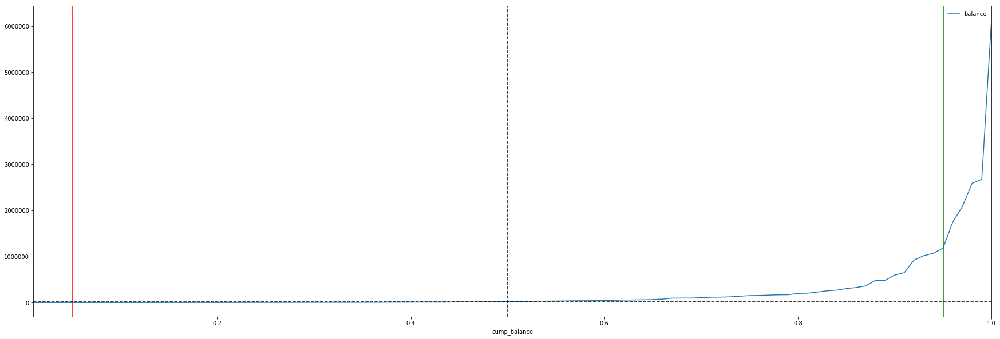

In [76]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.show()

In [77]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [78]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [79]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 112.41% or less.

There's a 5% chance that return ends at -97.82% or less.

There's a 95% chance that return ends at 11715.29% or less.

45.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

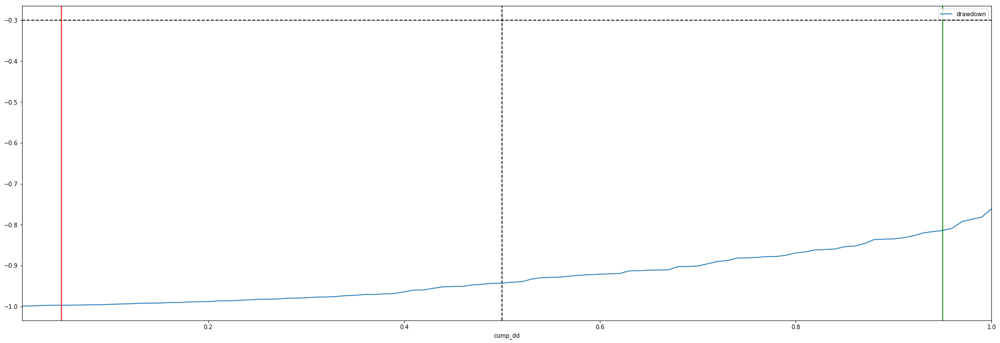

In [80]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.show()

In [81]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [82]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -94.10% or greater.

There's a 5% chance for MDD to be -99.73% or greater.

There's a 95% chance for MDD to be -81.45% or greater.

100.00% of simulations had greater MDD than -30.00%.


## D'Alembert position sizing

Each time the player looses the bet is increased by some fixed amount, when the player wins the bet size is reduced by the same amount.

In [83]:
def dalembert_bettor(initial_funds, bet_size, plays, increase_on_win=False, increase_by=1):
    current_funds = initial_funds
    current_bet = bet_size
    
    delta = bet_size * increase_by
    
    bets = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_bet in range(plays):
        if current_funds > 0:
            if play():
                current_funds += current_bet

                if increase_on_win:
                    current_bet += delta
                else:
                    current_bet -= delta
            else:
                current_funds -= current_bet

                if increase_on_win:
                    current_bet -= delta
                else:
                    current_bet += delta

        bets = np.append(bets, single_bet)
        
        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)
        
        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
            
    plt.figure(0)
    plt.plot(bets, funds)
    
    plt.figure(1)
    plt.plot(bets, drawdown)
    
    return (current_funds, min(drawdown))

### Increase or decrease by 10% of the initial bet amount

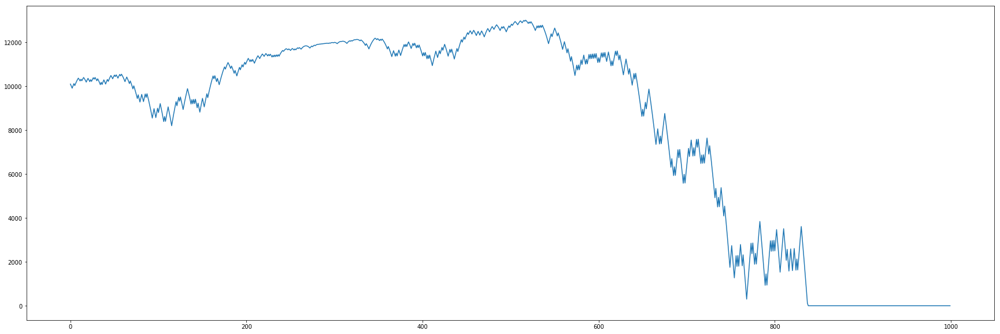

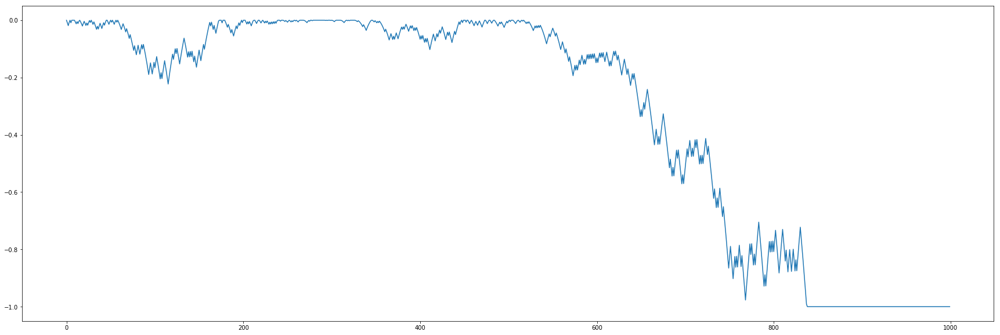

In [84]:
dalembert_bettor(init_capital, 100, 1000, increase_by=.10)
plt.show()

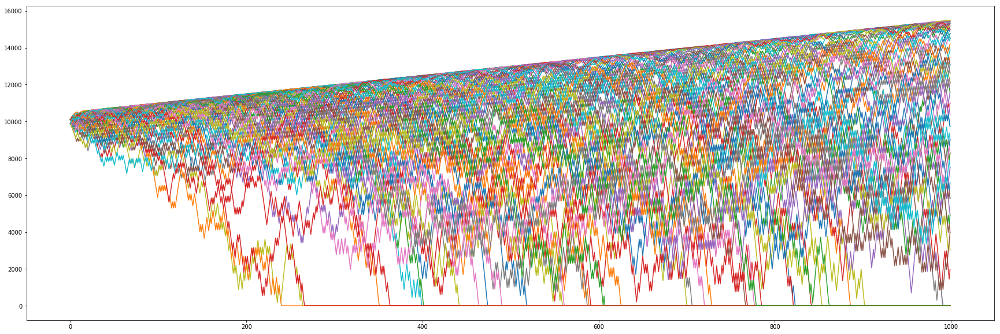

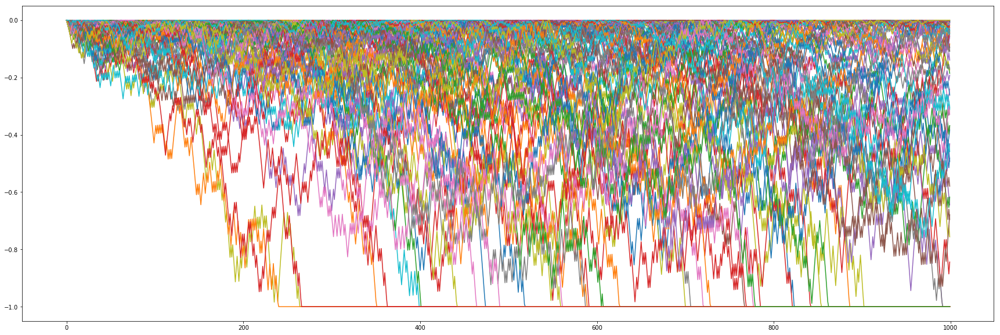

In [85]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(100):
    run_result, run_dd = dalembert_bettor(init_capital, 100, 1000, increase_by=.10)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [86]:
dalembert_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(dalembert_results)

dalembert_results['cump_balance'] = percent_unit
dalembert_results['cump_dd'] = percent_unit

dalembert_results['cump_balance'] = dalembert_results.sort_values('balance').cump_balance.cumsum()
dalembert_results['cump_dd'] = dalembert_results.sort_values('drawdown').cump_dd.cumsum()

In [87]:
dalembert_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,7418.800000,-0.662183,0.505000,0.505000
std,6459.283395,0.319675,0.290115,0.290115
min,0.000000,-1.000000,0.010000,0.010000
25%,0.000000,-1.000000,0.257500,0.257500
50%,8280.000000,-0.716622,0.505000,0.505000
75%,14295.000000,-0.336242,0.752500,0.752500
max,15500.000000,-0.124120,1.000000,1.000000


In [88]:
balance_results = dalembert_results.sort_values('balance')
drawdown_results = dalembert_results.sort_values('drawdown')

### CDF Ending Balance

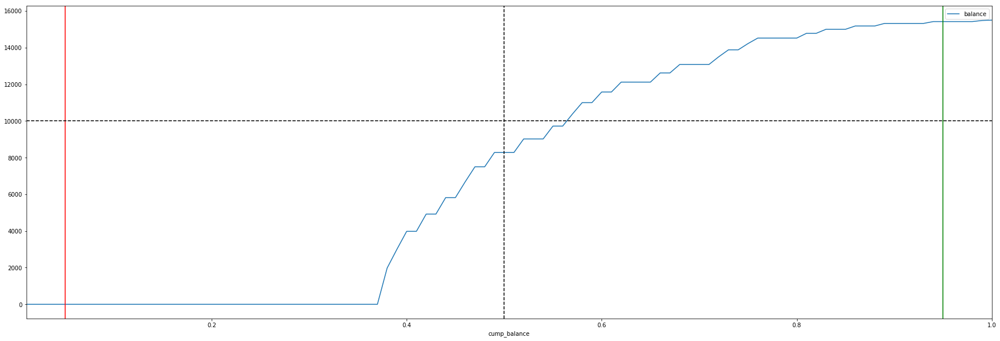

In [89]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.show()

In [90]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [91]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [92]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at -17.20% or less.

There's a 5% chance that return ends at -100.00% or less.

There's a 95% chance that return ends at 54.20% or less.

57.00% of simulations had capital lost.
37.00% of simulations lost everything.


### CDF Maximum Drawdown

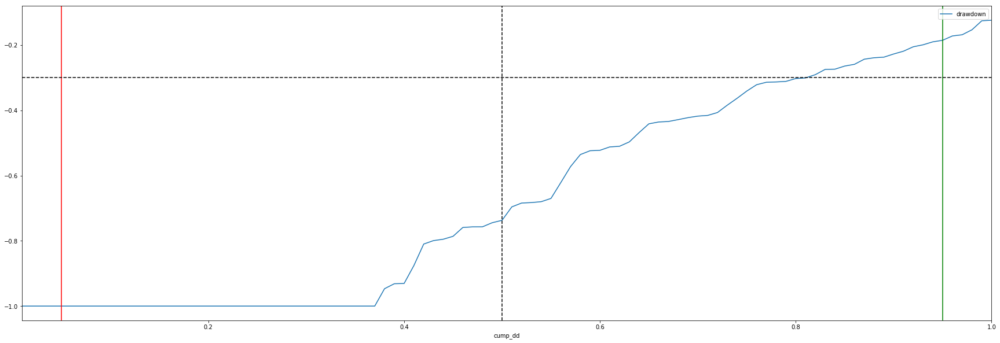

In [93]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.show()

In [94]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [95]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -69.60% or greater.

There's a 5% chance for MDD to be -100.00% or greater.

There's a 95% chance for MDD to be -18.55% or greater.

81.00% of simulations had greater MDD than -30.00%.


### Inverse D'Alembert

Now when loosing we decrease by 10% of the initial bet size, and when winning we increase by that same amount.

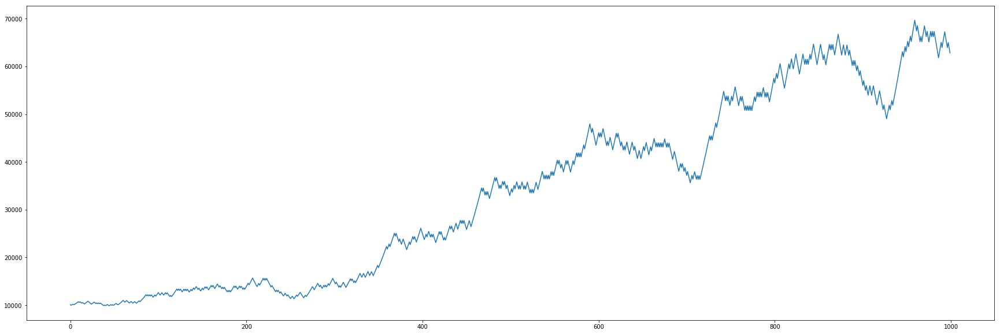

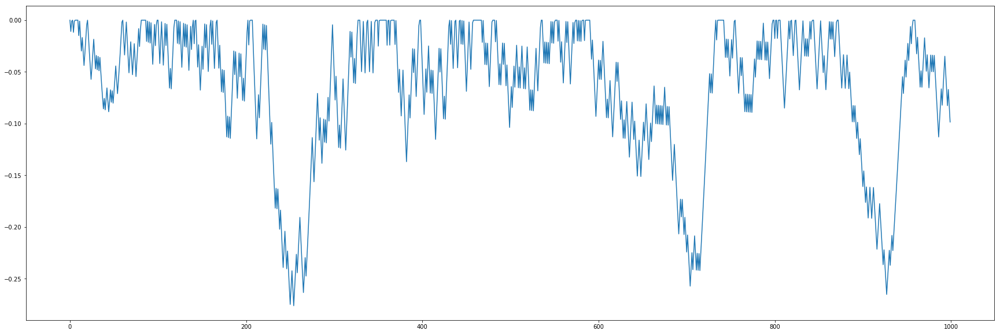

In [96]:
dalembert_bettor(init_capital, 100, 1000, increase_by=.10, increase_on_win=True)
plt.show()

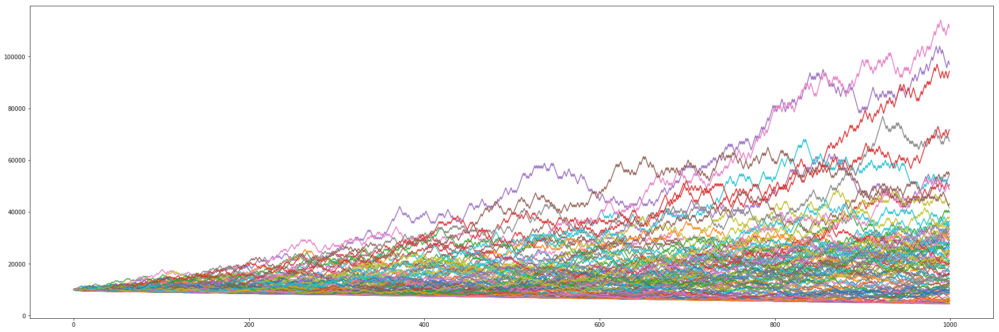

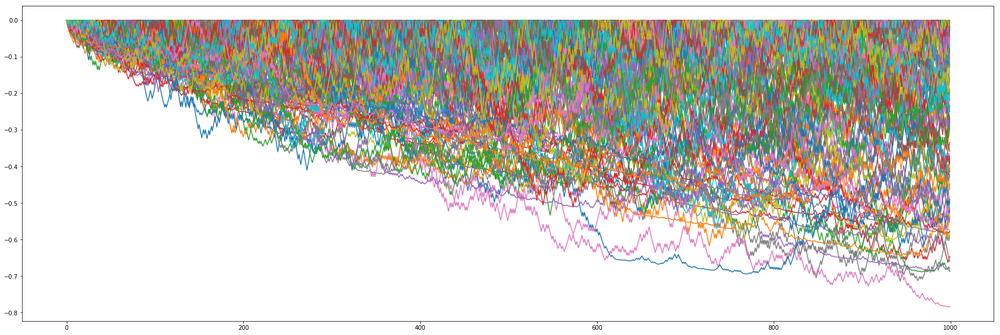

In [97]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(100):
    run_result, run_dd = dalembert_bettor(init_capital, 100, 1000, increase_by=.10, increase_on_win=True)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [98]:
dalembertip_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(dalembertip_results)

dalembertip_results['cump_balance'] = percent_unit
dalembertip_results['cump_dd'] = percent_unit

dalembertip_results['cump_balance'] = dalembertip_results.sort_values('balance').cump_balance.cumsum()
dalembertip_results['cump_dd'] = dalembertip_results.sort_values('drawdown').cump_dd.cumsum()

In [99]:
dalembertip_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,23164.000000,-0.463972,0.505000,0.505000
std,19885.023856,0.121645,0.290115,0.290115
min,4500.000000,-0.784107,0.010000,0.010000
25%,9465.000000,-0.548134,0.257500,0.257500
50%,18040.000000,-0.464531,0.505000,0.505000
75%,30420.000000,-0.365909,0.752500,0.752500
max,111080.000000,-0.219825,1.000000,1.000000


In [100]:
balance_results = dalembertip_results.sort_values('balance')
drawdown_results = dalembertip_results.sort_values('drawdown')

### CDF Ending Balance

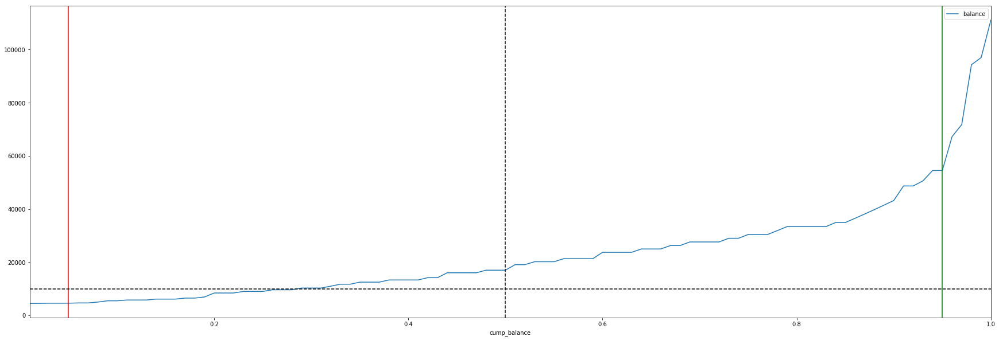

In [101]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.show()

In [102]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [103]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [104]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 90.80% or less.

There's a 5% chance that return ends at -54.20% or less.

There's a 95% chance that return ends at 445.00% or less.

29.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

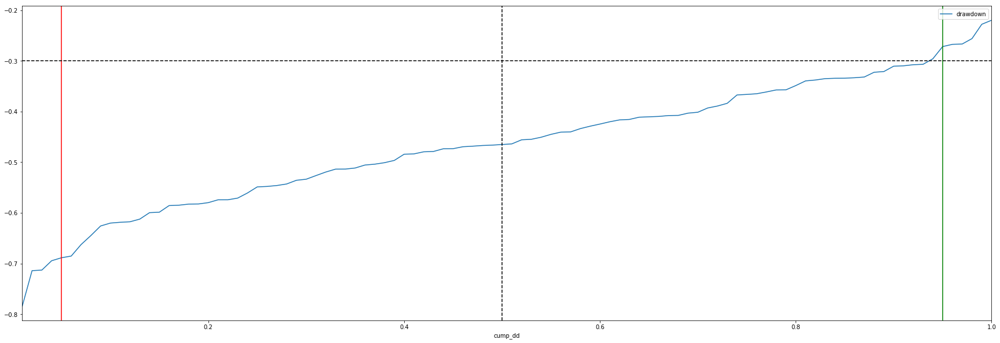

In [105]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.show()

In [106]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [107]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -46.39% or greater.

There's a 5% chance for MDD to be -68.87% or greater.

There's a 95% chance for MDD to be -27.18% or greater.

93.00% of simulations had greater MDD than -30.00%.
